<a href="https://colab.research.google.com/github/baekhos/Mind-The-Gap-Introducere-in-Imagistica-Digitala/blob/main/Mind_The_Gap_Introducere_in_imagistica_digitala.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1.Pixeli si plane de culoare

In urmatoarea aplicatie o sa vedem, ce efect are ajustarea pixelilor cu o valoare fixa, atat pe planul alb negru cat si pe imaginea color. O sa adunam o valoare arbitrara fiecarui pixel din imagine si vom observa cum imaginea se schimba atunci cand facem asta. Valoarea adunata poate fi una pozitiva sau negativa, insa vom limita pixelii in intervalul [0,255].

## Imaginea alb-negru

In [ ]:
#@title Importam imaginile pe care urmeaza sa le folosim
import urllib.request
MOZI_IMAGE_URL = "https://i.ibb.co/Lz8Q034/cat-pic.jpg"
MOZI_SMALL_IMAGE_URL = "https://i.ibb.co/s9kTvZy/rsz-cat-pic.jpg"
SNOW1_SEGMENTARE_IMAGE_URL = "https://i.ibb.co/Sw48MxB/snowboard3.jpg"
SNOW2_SEGMENTARE_IMAGE_URL = "https://i.ibb.co/vxDqY1P/snowboar2.jpg"
SNOW3_SEGMENTARE_IMAGE_URL = "https://i.ibb.co/kKzBk51/snowboard1.jpg"
urllib.request.urlretrieve(MOZI_IMAGE_URL, "cat_image.jpg")
urllib.request.urlretrieve(MOZI_SMALL_IMAGE_URL, "cat_image_small.jpg")
urllib.request.urlretrieve(SNOW1_SEGMENTARE_IMAGE_URL, "snow1_segmentare.jpg")
urllib.request.urlretrieve(SNOW2_SEGMENTARE_IMAGE_URL, "snow2_segmentare.jpg")
urllib.request.urlretrieve(SNOW3_SEGMENTARE_IMAGE_URL, "snow3_segmentare.jpg")

('snow3_segmentare.jpg', <http.client.HTTPMessage at 0x7f4ee2f2a990>)

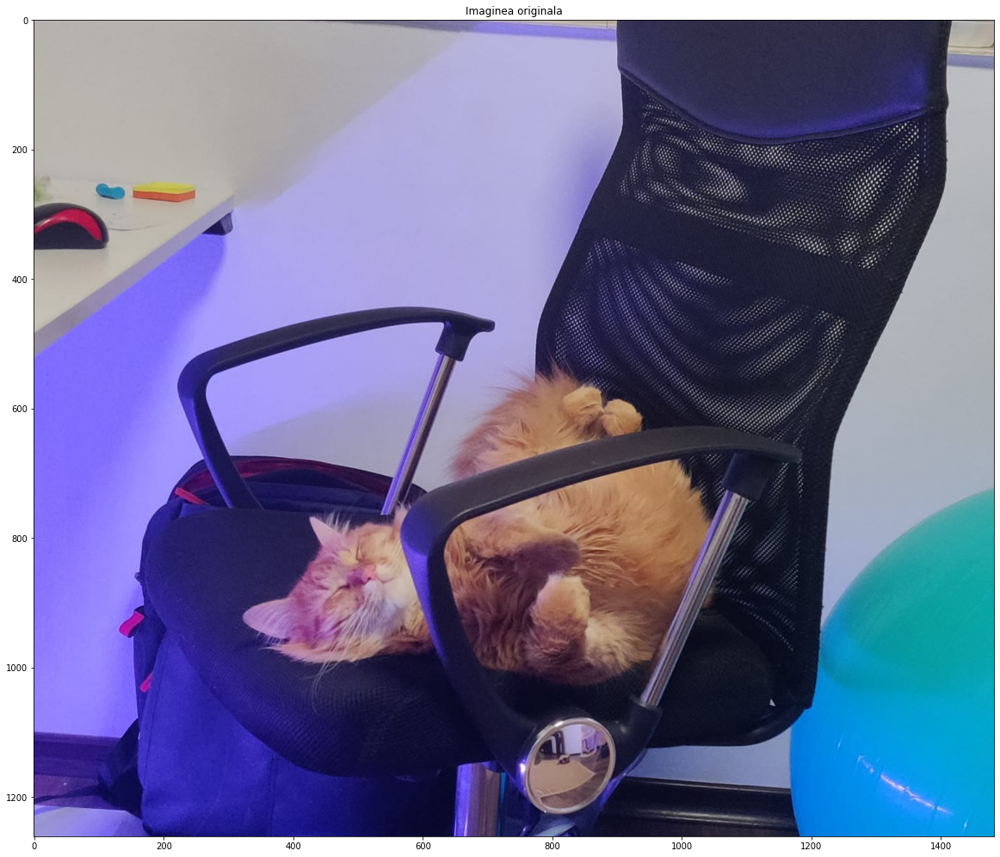

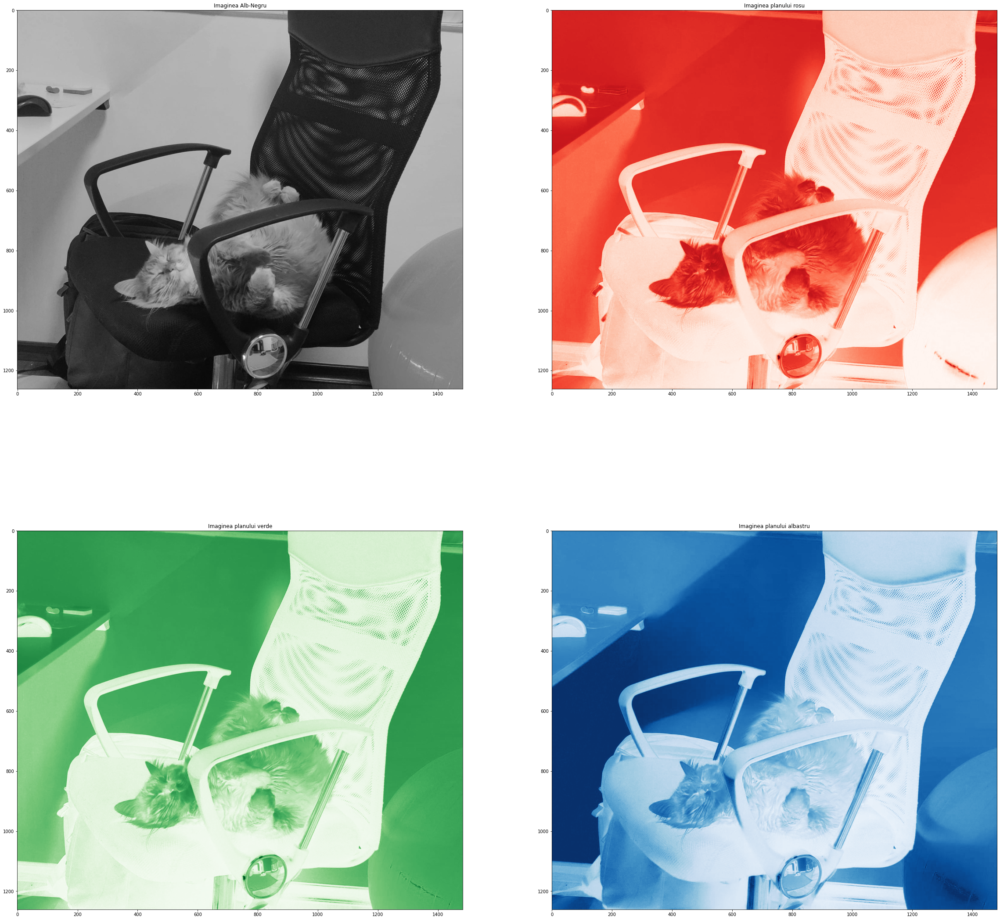

In [ ]:
#@title Vom vizualiza imaginea in forma ei originala, in alb negru cat si fiecare plan de culoare ce alcatuieste imaginea color
import urllib.request
from skimage import io,color
import matplotlib.pyplot as plt
import numpy as np


img_originala = io.imread('cat_image.jpg')
img = img_originala.copy()
img_bw = color.rgb2gray(img)


plt.figure(figsize=(20,20))
plt.title("Imaginea originala")
plt.imshow(img)


fig=plt.figure(figsize=(40, 40))
fig.add_subplot(2, 2, 1)
plt.title("Imaginea Alb-Negru")
plt.imshow(img_bw,cmap='gray')
fig.add_subplot(2, 2, 2)
plt.title("Imaginea planului rosu")
plt.imshow(img[:,:,0],cmap='Reds')
fig.add_subplot(2, 2, 3)
plt.title("Imaginea planului verde")
plt.imshow(img[:,:,1],cmap='Greens')
fig.add_subplot(2, 2, 4)
plt.title("Imaginea planului albastru")
plt.imshow(img[:,:,2],cmap='Blues')
plt.show()

## Imaginea alb negru.

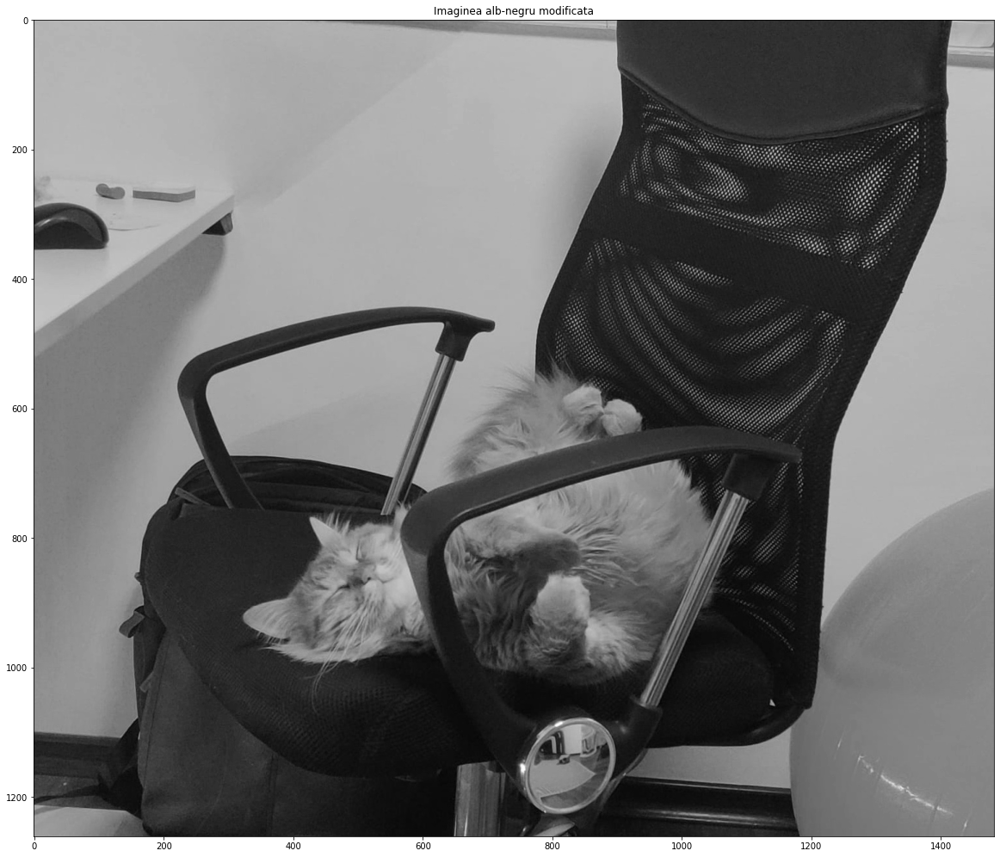

In [ ]:
#@title Ajustati offset-ul pentru planul gri { run: "auto" }

offset_alb_negru = 1 #@param {type:"slider", min:-255, max:255, step:1}
img_bw = color.rgb2gray(img)
img_bw*=255
img_bw = np.clip(img_bw + offset_alb_negru,0,255)

plt.figure(figsize=(20,20))
plt.title("Imaginea alb-negru modificata")
plt.imshow(img_bw, cmap="gray")

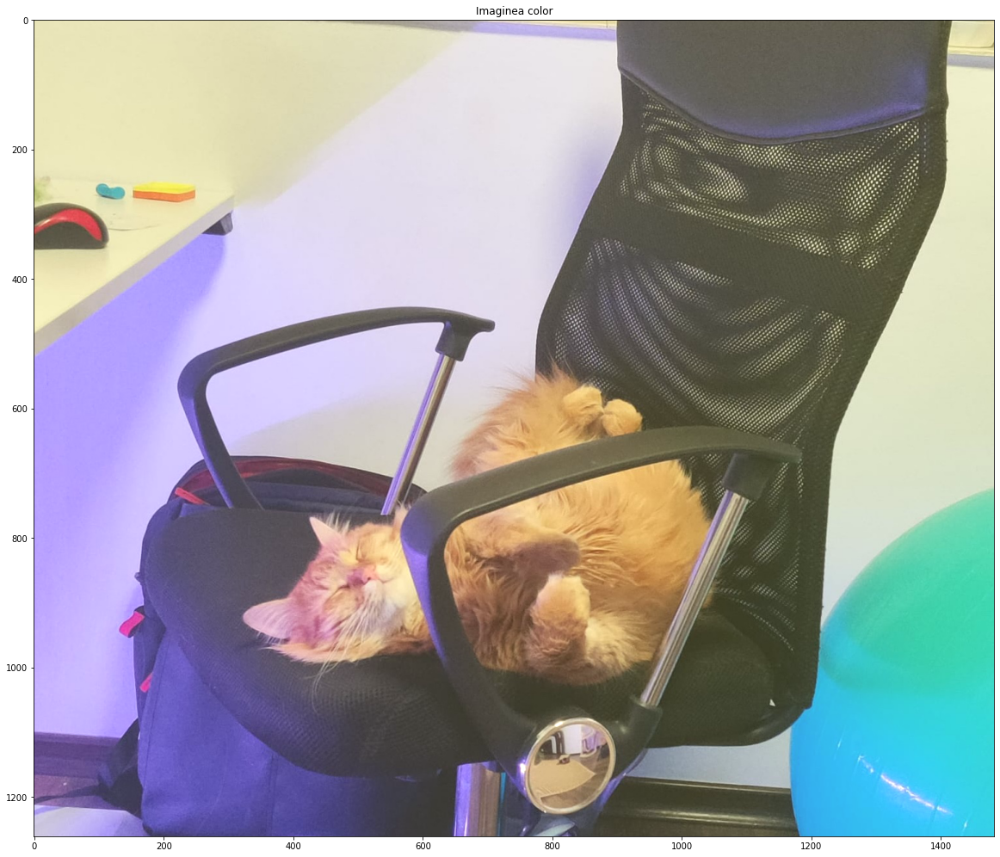

In [ ]:
#@title Ajustati offset-ul pentru planurile de culoare { run: "auto" }

offset_rosu = 51 #@param {type:"slider", min:-255, max:255, step:1}
offset_verde = 50 #@param {type:"slider", min:-255, max:255, step:1}
offset_albastru = 11 #@param {type:"slider", min:-255, max:255, step:1}
img = img_originala.copy()
img = np.clip(img + [offset_rosu,offset_verde,offset_albastru],0,255)

plt.figure(figsize=(20,20))
plt.title("Imaginea color")
plt.imshow(img)


# 2.Imbunatatirea imaginilor



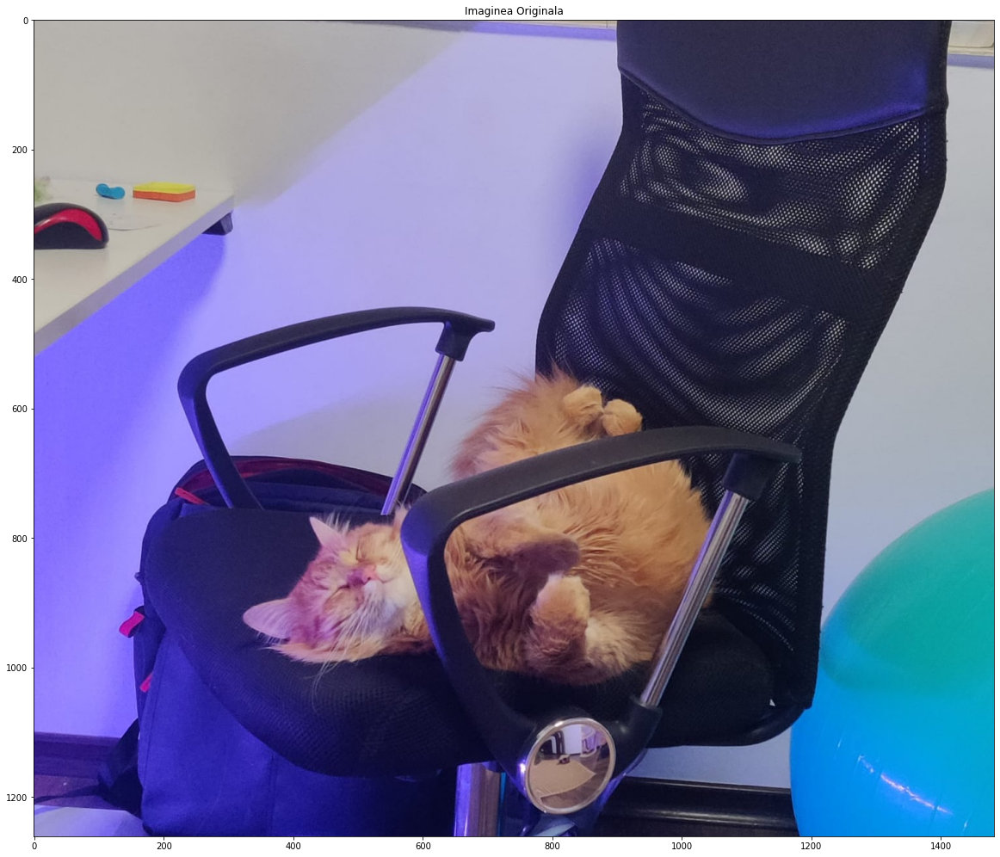

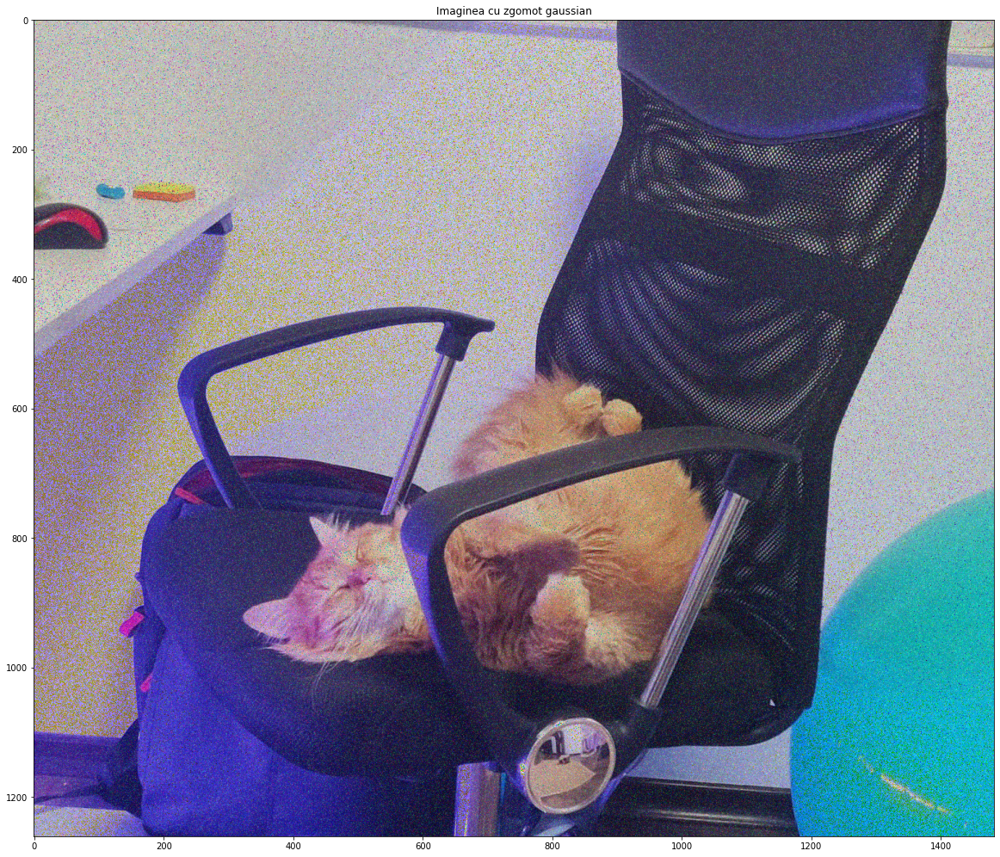

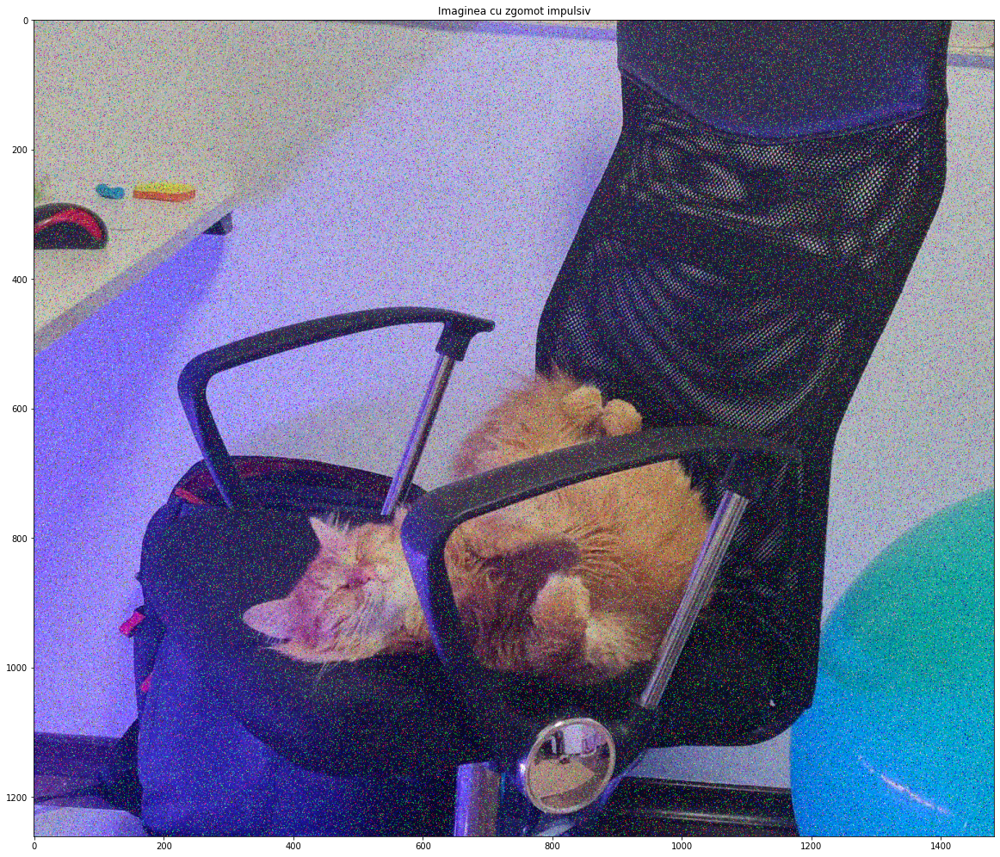

In [ ]:
#@title In aplicatia urmatoare, avem o imaginea originala, si inca 2 variante alterate de zgomot. { run: "auto" }
import numpy as np
import matplotlib.pyplot as plt
from skimage import io,color

def gauss(img_in):
    img = img_in.copy()
    zg = np.random.normal(0,40,img.shape)
    zg[zg>255] = 255
    zg[zg<0] = 0
    return np.uint8(img + zg)

def impulse(img_in):
    img = img_in.copy()
    l,c,ch = img.shape
    lines = np.random.randint(0,l,[3,l*c//10])
    columns = np.random.randint(0,c,[3,l*c//10])
    up_down = np.random.randint(0,2,[3,l*c//10])
    for i in range(lines.shape[0]):
        for j in range(lines.shape[1]):
            img[lines[i,j],columns[i,j],i] = 255 * up_down[i,j]    
    return img

img_clean = io.imread('cat_image.jpg')
img_gauss= gauss(img_clean)
img_impulsiv = impulse(img_clean)

plt.figure(figsize=(20,20))
plt.title("Imaginea Originala")
plt.imshow(img_clean)
plt.figure(figsize=(20,20))
plt.title("Imaginea cu zgomot gaussian")
plt.imshow(img_gauss)
plt.figure(figsize=(20,20))
plt.title("Imaginea cu zgomot impulsiv")
plt.imshow(img_impulsiv)

In [ ]:
#@title Vom defini algoritmi care ne vor ajuta sa imbunatatim imaginile in functie de caz.
def medie_artimetica(image_input, kernel):
  img_out = image_input.copy()
  for i in range(1,image_input.shape[0]-1):
    for j in range(1,image_input.shape[1]-1):
        for k in range(image_input.shape[2]):
            V = np.sum(image_input[i-1:i+2,j-1:j+2,k]*kernel)
            img_out[i,j,k] = V
  return img_out

def median_filter(image_input):
    img_out = image_input.copy()
    for i in range(1,image_input.shape[0]-1):
      for j in range(1,image_input.shape[1]-1):
        for k in range(image_input.shape[2]):
            V = np.sort(image_input[i-1:i+2,j-1:j+2,k],axis=None)
            img_out[i,j,k] = V[4]
    return img_out

filter_dict={}
kernel_1= np.ones([3,3])/9
kernel_2= -np.ones([3,3])
kernel_2[1,1] = 5
kernel_2[0,0], kernel_2[0,2], kernel_2[2,0], kernel_2[2,2] = 0,0,0,0
kernel_3= np.ones([3,3])/5
kernel_3[0,0],kernel_3[0,2],kernel_3[2,0],kernel_3[2,2] = 0, 0, 0, 0

def apply_filter(image, filtering):
  img_out = image.copy()
  if filtering == 'medie_aritmetica_1/9':
    return medie_artimetica(img_out, kernel_1)
  elif filtering == 'medie_aritmetica_1/5':
    return medie_artimetica(img_out, kernel_3)
  elif filtering == 'filtru_median':
    return median_filter(img_out)
  elif filtering == 'filtru_contrast':
    return medie_artimetica(img_out, kernel_2)
  else:
    raise Exception('Filtru necunoscut')


### Vom selecta una din cele 3 imagini: originala, cu zgomot sare si piper si cu zgomot impulsiv, si vom observa efectul pe care il are aplicarea filtrelor pe acestea.

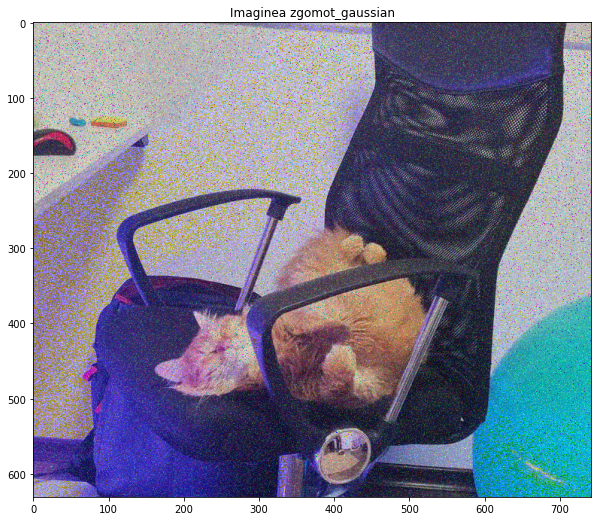

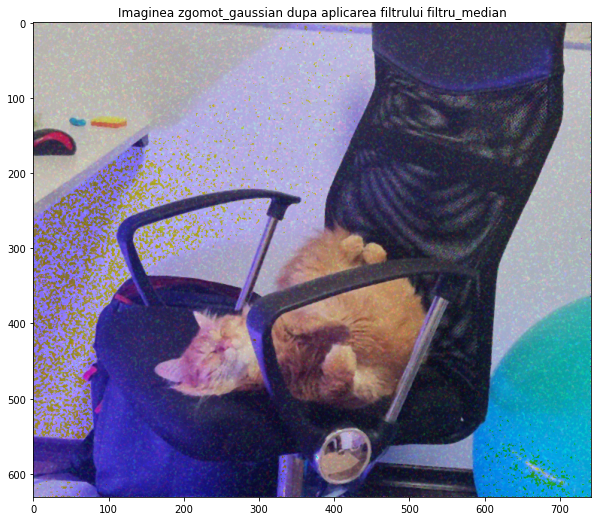

In [ ]:
#@title Selectati o imagine si filtrul pe care doriti sa il aplicati pe aceasta { run: "auto" }
imagini_dict = {}

imagini_dict['originala'] = io.imread('cat_image_small.jpg')
imagini_dict['zgomot_gaussian']= gauss(imagini_dict['originala'])
imagini_dict['zgomot_impulsiv'] = impulse(imagini_dict['originala'])
imagini_dict['imagine_blurata'] = apply_filter(imagini_dict['originala'],"medie_aritmetica_1/9")

imagine = 'zgomot_gaussian' #@param ["originala", "imagine_blurata", "zgomot_gaussian", "zgomot_impulsiv"]
filtru = 'medie_aritmetica_1/5' #@param ["medie_aritmetica_1/9", "medie_aritmetica_1/5", "filtru_median", "filtru_contrast"]

plt.figure(figsize=(10,10))
plt.title("Imaginea {}".format(imagine))
plt.imshow(imagini_dict[imagine])
plt.figure(figsize=(10,10))
plt.title("Imaginea {} dupa aplicarea filtrului {}".format(imagine,filtru))
plt.imshow(apply_filter(imagini_dict[imagine],filtru))

# 3.Segmentarea imaginilor

(<Figure size 1440x720 with 1 Axes>,
 Text(0.5, 1.0, 'Imagine alb-negru'),
 <matplotlib.image.AxesImage at 0x7f4ee2466690>)

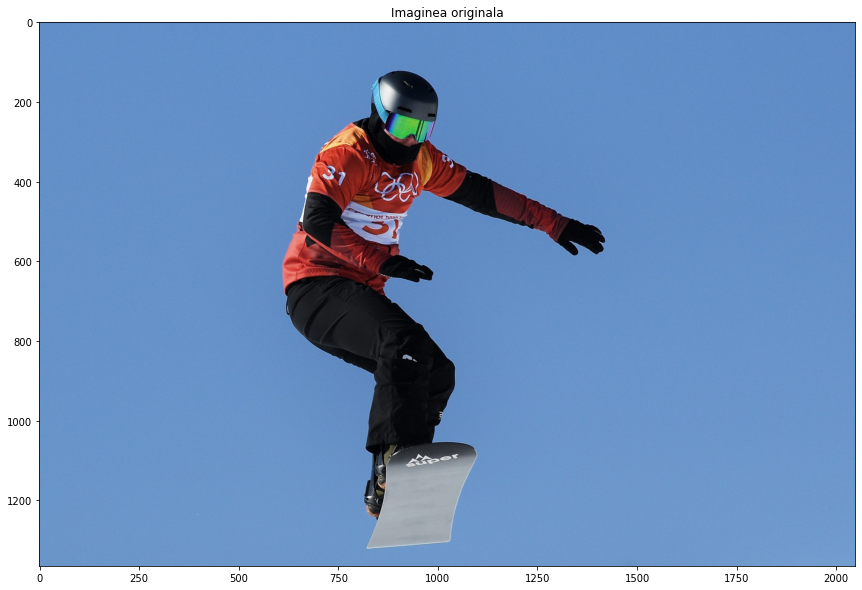

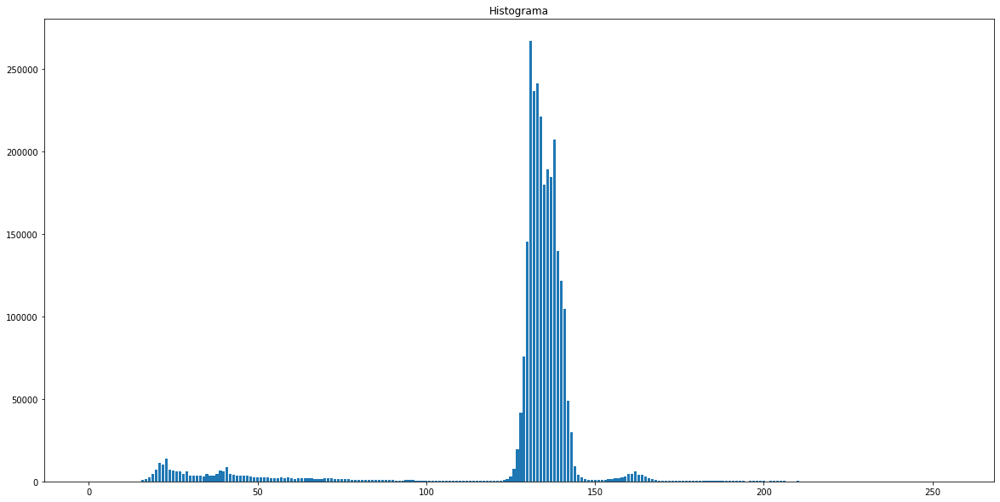

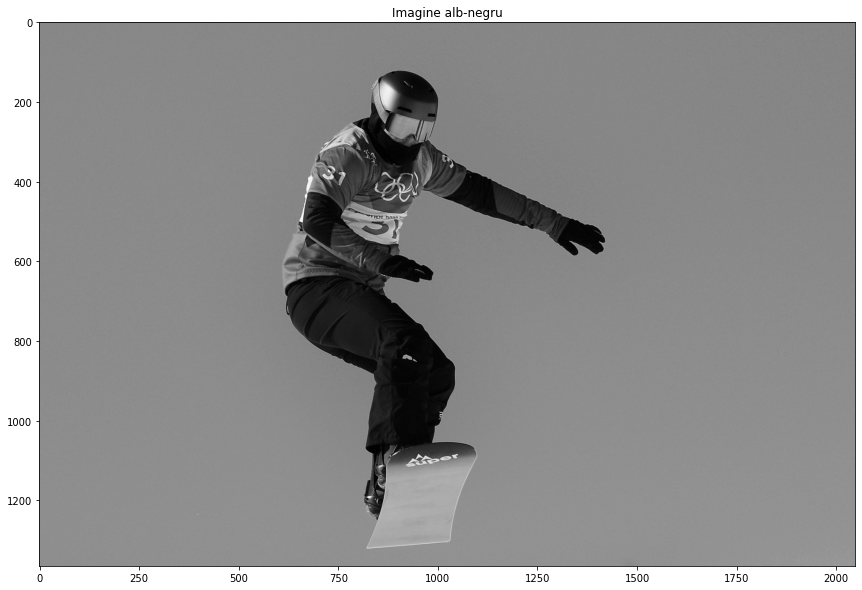

In [ ]:
#@title Selectati una din cele 3 imagini si analizati histograma.{ run: "auto" }

import numpy as np
import matplotlib.pyplot as plt
from skimage import io,color,measure

image_dict = {"snowboarder 1": "snow1_segmentare.jpg",
              "snowboarder 2": "snow2_segmentare.jpg",
              "snowboarder 3": "snow3_segmentare.jpg",}
imagine = "snowboarder 1" #@param ["snowboarder 1", "snowboarder 2", "snowboarder 3"]
img = io.imread(image_dict[imagine])

img_bw = color.rgb2ycbcr(img)[:,:,0].astype(np.uint8)
hist,_ = np.histogram(img_bw, bins=256, range=(0,255))



plt.figure(figsize=(20,10)),plt.title('Imaginea originala'),plt.imshow(img)
plt.figure(figsize=(20,10)),plt.title('Histograma'),plt.bar(range(256),hist)
plt.figure(figsize=(20,10)),plt.title('Imagine alb-negru'),plt.imshow(img_bw, cmap='gray')

(<Figure size 1440x720 with 1 Axes>,
 Text(0.5, 1.0, 'Imaginea segmentata'),
 <matplotlib.image.AxesImage at 0x7fd4637c8310>)

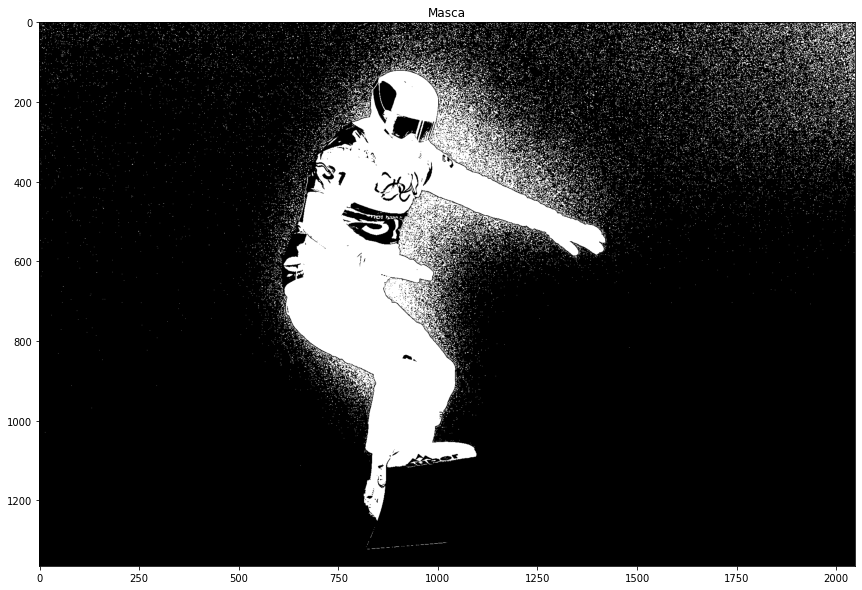

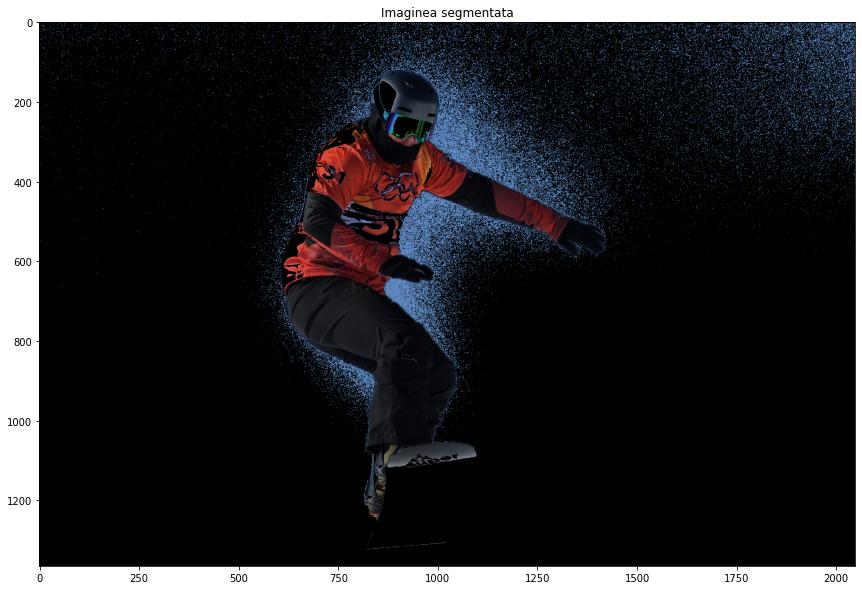

In [ ]:
#@title Gasiti intervalele de separatie pentru a extrage obiectul din prim plan { run: "auto" }
limita_inferioara = 0  #@param {type:"number"}
limita_superioara = 130  #@param {type:"number"}
mask = np.zeros(img_bw.shape)
for i in range(mask.shape[0]):
  for j in range(mask.shape[1]):
    if img_bw[i,j] < limita_superioara and img_bw[i,j] > limita_inferioara:
      mask[i,j] = 255
new_img = img.copy()
new_img[:,:,0][mask==0] = 0
new_img[:,:,1][mask==0] = 0
new_img[:,:,2][mask==0] = 0

plt.figure(figsize=(20,10)),plt.title('Masca'),plt.imshow(mask, cmap='gray')
plt.figure(figsize=(20,10)),plt.title('Imaginea segmentata'),plt.imshow(new_img)